In [1]:
import sys
sys.path.insert(0, "../../../")

# to be included in the photo_meson.py script
import numpy as np
import astropy.units as u
from astropy.constants import c, h, m_p
from agnpy.photo_meson.kernels import PhiKernel, secondaries, eta_0
from agnpy.utils.math import axes_reshaper, ftiny, fmax
from agnpy.utils.conversion import mpc2

# to be used only for the the validation
from astropy.modeling.models import BlackBody
import matplotlib.pyplot as plt
from agnpy.emission_regions import Blob
from agnpy.spectra import PowerLaw, ExpCutoffPowerLaw

/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:224: RuntimeWarning: invalid value encountered in power
  _exp = np.exp(-s * np.log(x / x_minus) ** delta)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:225: RuntimeWarning: invalid value encountered in power
  _log = np.log(2 / (1 + y**2)) ** psi
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:224: RuntimeWarning: invalid value encountered in power
  _exp = np.exp(-s * np.log(x / x_minus) ** delta)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:225: RuntimeWarning: invalid value encountered in power
  _log = np.log(2 / (1 + y**2)) ** psi


Text(0.2, 0.6, '$\\eta$ = 30.0 $\\eta_{0}$')

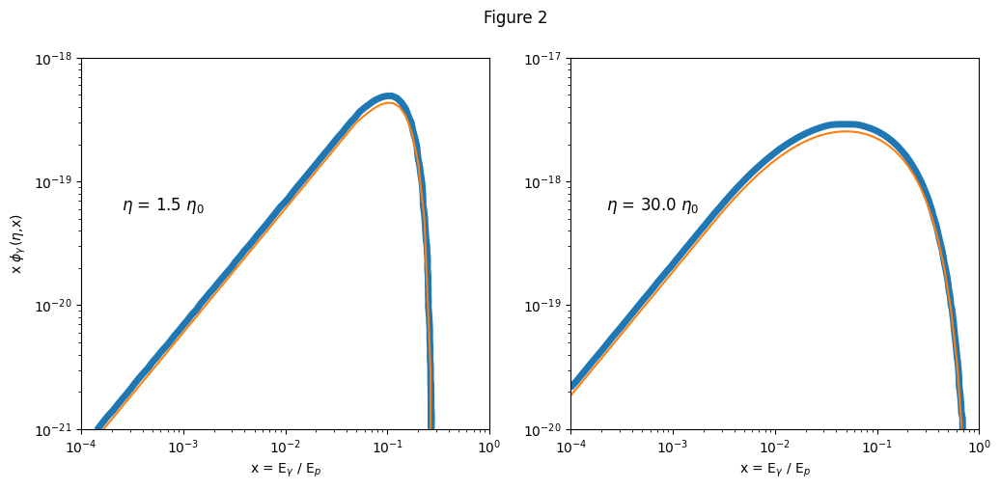

In [2]:
"""""
[KelnerAharonian2008] figure 2
"""

x = np.logspace(-5,1,100)

phi_kernel = PhiKernel("gamma")

fig, ax = plt.subplots(1,2,figsize = (12, 5))

fig.suptitle("Figure 2")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig2_values/gamma_1.5eta0.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

eta = 1.5*eta_0
ax[0].loglog(x,x*phi_kernel(eta,x))

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig2_values/gamma_30eta0.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

eta = 30*eta_0
ax[1].loglog(x,x*phi_kernel(eta,x))

ax[0].set_xlim(1e-4,1e0)
ax[1].set_xlim(1e-4,1e0)

ax[0].set_ylim(1e-21,1e-18)
ax[1].set_ylim(1e-20,1e-17)

ax[0].set_xlabel(r"x = E$_{\gamma}$ / E$_{p}$")
ax[1].set_xlabel(r"x = E$_{\gamma}$ / E$_{p}$")

ax[0].set_ylabel(r"x $\phi_{\gamma\,}$($\eta$,x)")

ax[0].text(0.2, 0.6, r"$\eta$ = 1.5 $\eta_{0}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[1].text(0.2, 0.6, r"$\eta$ = 30.0 $\eta_{0}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:224: RuntimeWarning: invalid value encountered in power
  _exp = np.exp(-s * np.log(x / x_minus) ** delta)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:225: RuntimeWarning: invalid value encountered in power
  _log = np.log(2 / (1 + y**2)) ** psi
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:224: RuntimeWarning: invalid value encountered in power
  _exp = np.exp(-s * np.log(x / x_minus) ** delta)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:225: RuntimeWarning: invalid value encountered in power
  _log = np.log(2 / (1 + y**2)) ** psi


Text(0.2, 0.6, '$\\eta$ = 30.0 $\\eta_{0}$')

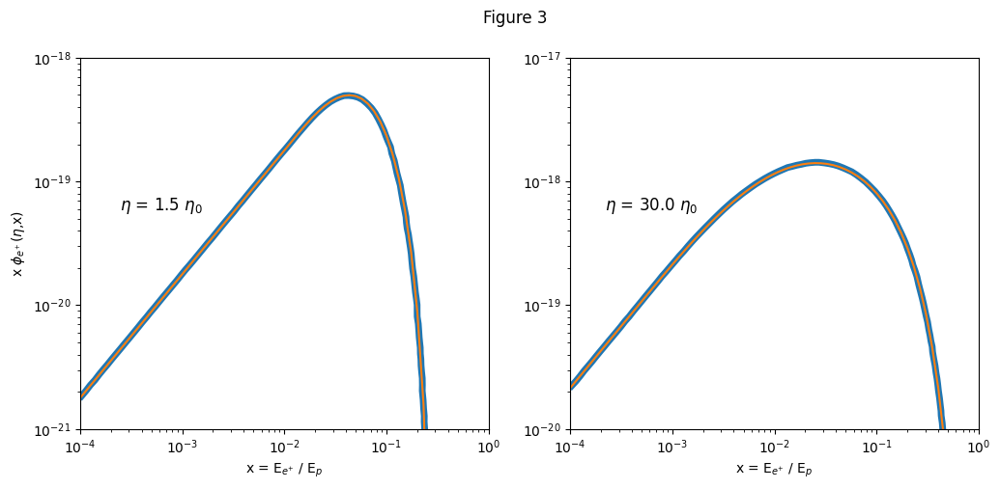

In [3]:
"""""
[KelnerAharonian2008] figure 3
"""

x = np.logspace(-5,1,100)

phi_kernel = PhiKernel("positron")

fig, ax = plt.subplots(1,2,figsize = (12, 5))

fig.suptitle("Figure 3")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig3_values/positron_1.5eta0.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

eta = 1.5*eta_0
ax[0].loglog(x,x*phi_kernel(eta,x))

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig3_values/positron_30eta0.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

eta = 30*eta_0
ax[1].loglog(x,x*phi_kernel(eta,x))

ax[0].set_xlim(1e-4,1e0)
ax[1].set_xlim(1e-4,1e0)

ax[0].set_ylim(1e-21,1e-18)
ax[1].set_ylim(1e-20,1e-17)

ax[0].set_xlabel(r"x = E$_{e^{+}}$ / E$_{p}$")
ax[1].set_xlabel(r"x = E$_{e^{+}}$ / E$_{p}$")

ax[0].set_ylabel(r"x $\phi_{e^{+}\,}$($\eta$,x)")

ax[0].text(0.2, 0.6, r"$\eta$ = 1.5 $\eta_{0}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[1].text(0.2, 0.6, r"$\eta$ = 30.0 $\eta_{0}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:224: RuntimeWarning: invalid value encountered in power
  _exp = np.exp(-s * np.log(x / x_minus) ** delta)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:225: RuntimeWarning: invalid value encountered in power
  _log = np.log(2 / (1 + y**2)) ** psi
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:224: RuntimeWarning: invalid value encountered in power
  _exp = np.exp(-s * np.log(x / x_minus) ** delta)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:225: RuntimeWarning: invalid value encountered in power
  _log = np.log(2 / (1 + y**2)) ** psi


Text(0.2, 0.7, '$\\eta$ = 30.0 $\\eta_{0}$')

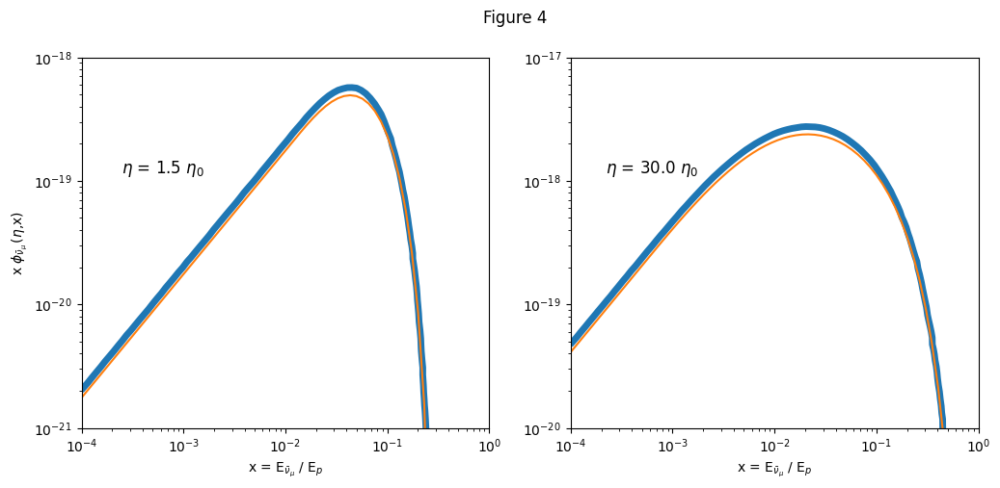

In [4]:
"""""
[KelnerAharonian2008] figure 4
"""

x = np.logspace(-5,1,100)

phi_kernel = PhiKernel("muon_antineutrino")

fig, ax = plt.subplots(1,2,figsize = (12, 5))

fig.suptitle("Figure 4")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig4_values/muon_antineutrino_1.5eta0.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

eta = 1.5*eta_0
ax[0].loglog(x,x*phi_kernel(eta,x))

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig4_values/muon_antineutrino_30eta0.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

eta = 30*eta_0
ax[1].loglog(x,x*phi_kernel(eta,x))

ax[0].set_xlim(1e-4,1e0)
ax[1].set_xlim(1e-4,1e0)

ax[0].set_ylim(1e-21,1e-18)
ax[1].set_ylim(1e-20,1e-17)

ax[0].set_xlabel(r"x = E$_{\bar{\nu}_{\mu}}$ / E$_{p}$")
ax[1].set_xlabel(r"x = E$_{\bar{\nu}_{\mu}}$ / E$_{p}$")

ax[0].set_ylabel(r"x $\phi_{\bar{\nu}_{\mu}\,}$($\eta$,x)")

ax[0].text(0.2, 0.7, r"$\eta$ = 1.5 $\eta_{0}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[1].text(0.2, 0.7, r"$\eta$ = 30.0 $\eta_{0}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:25: RuntimeWarning: divide by zero encountered in log10
  logy = np.log10(yy)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:224: RuntimeWarning: invalid value encountered in power
  _exp = np.exp(-s * np.log(x / x_minus) ** delta)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:225: RuntimeWarning: invalid value encountered in power
  _log = np.log(2 / (1 + y**2)) ** psi
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:25: RuntimeWarning: divide by zero encountered in log10
  logy = np.log10(yy)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:224: RuntimeWarning: invalid value encountered in power
  _exp = np.exp(-s * np.log(x / x_minus) ** delta)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../

Text(0.2, 0.7, '$\\eta$ = 30.0 $\\eta_{0}$')

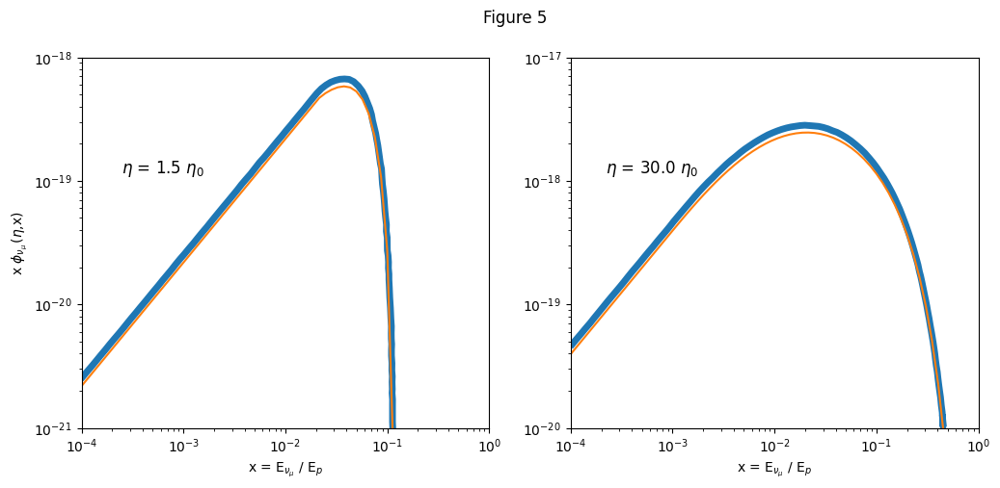

In [5]:
"""""
[KelnerAharonian2008] figure 5
"""

x = np.logspace(-5,1,100)

phi_kernel = PhiKernel("muon_neutrino")

fig, ax = plt.subplots(1,2,figsize = (12, 5))

fig.suptitle("Figure 5")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig5_values/muon_neutrino_1.5eta0.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

eta = 1.5*eta_0
ax[0].loglog(x,x*phi_kernel(eta,x))

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig5_values/muon_neutrino_30eta0.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

eta = 30*eta_0
ax[1].loglog(x,x*phi_kernel(eta,x))

ax[0].set_xlim(1e-4,1e0)
ax[1].set_xlim(1e-4,1e0)

ax[0].set_ylim(1e-21,1e-18)
ax[1].set_ylim(1e-20,1e-17)

ax[0].set_xlabel(r"x = E$_{\nu_{\mu}}$ / E$_{p}$")
ax[1].set_xlabel(r"x = E$_{\nu_{\mu}}$ / E$_{p}$")

ax[0].set_ylabel(r"x $\phi_{\nu_{\mu}\,}$($\eta$,x)")

ax[0].text(0.2, 0.7, r"$\eta$ = 1.5 $\eta_{0}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[1].text(0.2, 0.7, r"$\eta$ = 30.0 $\eta_{0}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

In [6]:
class BlackbodyTarget:
    
    def __init__(self, T):
        self.T = T
        self.bb = BlackBody(T)
        
    def __call__(self, nu):
        return (
            4. * np.pi * u.Unit("sr") * self.bb(nu)
            / (c * h**2 * nu)
        ).to("cm-3 erg-1")

In [7]:
cmb_target = BlackbodyTarget(T = 2.7 * u.Unit("K"))

In [8]:
def dNdx(x, Ep, particle_type):
    # Ep = (1e20 * u.Unit("eV")).to("erg")
    epsilon0 = (eta_0*mpc2**2/(4.0*Ep)).to_value("erg")
    # print(epsilon0)
    # print(np.log10(epsilon0))
    # print(np.logspace(np.log10(epsilon0),np.log10(epsilon0)+8,100))
    eps_val = np.logspace(np.log10(epsilon0),np.log10(epsilon0)+8,100)*u.Unit("erg")
    # print(eps_val)
    # print(cmb_target((eps_val/h).to("Hz")))
    fph = cmb_target((eps_val/h).to("Hz"))
    # print(fph)
    eta = 4.0 * eps_val * Ep / (mpc2**2)

    phi_kernel = PhiKernel(particle_type)
    
    phi = phi_kernel(eta,x)
    # print(phi)
    # print(fph*phi)
    Y = (fph*phi).to_value("1 / (erg s)")
    # print(Y)
    X = eps_val.to_value("erg")
    int_res = np.trapezoid(Y, x=X)*u.Unit("1 / s")
    # print(int_res)
    return int_res
    

x_val = np.logspace(-4, 0, 100)

Ep = (1e20 * u.Unit("eV")).to("erg")

def xdNdx_val(x_val,Ep,particle_type):
    xdNdx_val = []

    for i in x_val:
        # print(i*dNdx(i,Ep,"gamma"))
        xdNdx_val.append(i*dNdx(i,Ep,particle_type).to_value("1/s"))
    
    return xdNdx_val

# def xdNdx_i(x_val, Ep, particle_type):

#     dNdx_vals = np.vectorize(lambda x: dNdx_i(x, Ep, particle_type).to_value("1 / s"))(x_val)

#     return x_val * dNdx_vals
Tab = xdNdx_val(x_val,Ep,"gamma")

/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid value encountered in sqrt
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid value encountered in power
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid 

In [9]:
# print(Tab)

In [10]:
# """""
# [KelnerAharonian2008] figure 6
# """

# fig, ax = plt.subplots(1,2,figsize = (12, 5))

# fig.suptitle("Figure 6")

# Ep = (1e20 * u.Unit("eV")).to("erg")

# ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"gamma"))
# ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"positron"))
# ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"electron"))

# ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"muon_antineutrino"),label=r"$\bar{\nu}_{\mu}$")
# ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"muon_neutrino"),label=r"$\nu_{\mu}$")
# ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"electron_neutrino"),label=r"$\nu_{e}$")
# ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"electron_antineutrino"),label=r"$\bar{\nu}_{e}$")

# ax[0].set_xlim(1e-4,1e0)
# ax[1].set_xlim(1e-4,1e0)

# ax[0].set_ylim(1e-19,2e-16)
# ax[1].set_ylim(1e-19,2e-16)

# ax[0].set_xlabel(r"x = E / E$_{p}$")
# ax[1].set_xlabel(r"x = E / E$_{p}$")

# ax[0].set_ylabel(r"x dN/dx,  s$^{-1}$")

# ax[0].text(0.2, 0.9, r"E$_{p}$ = 10$^{20}$ eV", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
# ax[0].text(0.17, 0.8, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
# ax[0].text(0.90, 0.8, r"$\gamma$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
# ax[0].text(0.70, 0.75, r"e$^{+}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
# ax[0].text(0.70, 0.25, r"e$^{-}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)

# ax[1].text(0.2, 0.9, r"E$_{p}$ = 10$^{20}$ eV", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)
# ax[1].text(0.17, 0.8, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

# ax[1].legend(loc=(0.5,0.25))

/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid value encountered in sqrt
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid value encountered in power
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid 

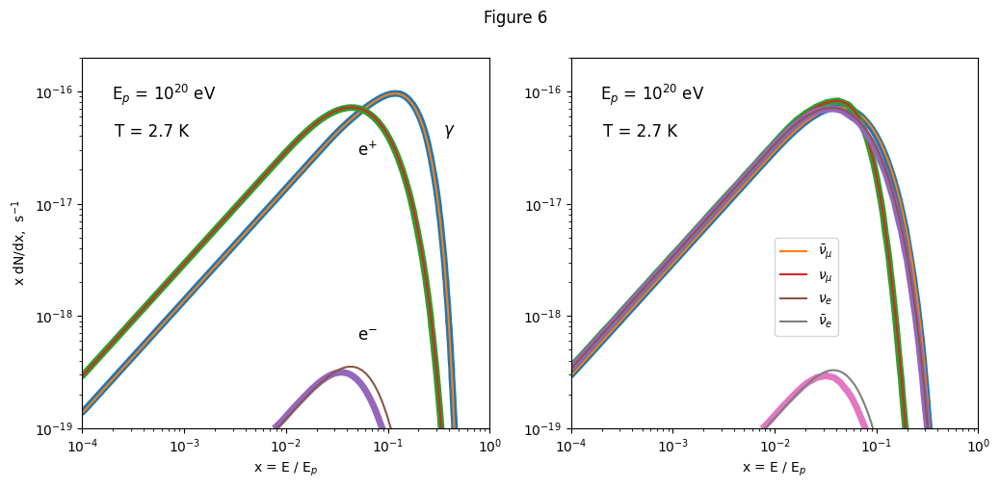

In [11]:
"""""
[KelnerAharonian2008] figure 6
"""

fig, ax = plt.subplots(1,2,figsize = (12, 5))

fig.suptitle("Figure 6")

Ep = (1e20 * u.Unit("eV")).to("erg")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig6_values/gamma.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"gamma"))

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig6_values/positron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"positron"))

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig6_values/electron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"electron"))

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig6_values/muon_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"muon_antineutrino"),label=r"$\bar{\nu}_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig6_values/muon_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"muon_neutrino"),label=r"$\nu_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig6_values/electron_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"electron_neutrino"),label=r"$\nu_{e}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig6_values/electron_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"electron_antineutrino"),label=r"$\bar{\nu}_{e}$")

# ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"gamma"))
# ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"positron"))
# ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"electron"))

# ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"muon_antineutrino"),label=r"$\bar{\nu}_{\mu}$")
# ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"muon_neutrino"),label=r"$\nu_{\mu}$")
# ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"electron_neutrino"),label=r"$\nu_{e}$")
# ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"electron_antineutrino"),label=r"$\bar{\nu}_{e}$")

ax[0].set_xlim(1e-4,1e0)
ax[1].set_xlim(1e-4,1e0)

ax[0].set_ylim(1e-19,2e-16)
ax[1].set_ylim(1e-19,2e-16)

ax[0].set_xlabel(r"x = E / E$_{p}$")
ax[1].set_xlabel(r"x = E / E$_{p}$")

ax[0].set_ylabel(r"x dN/dx,  s$^{-1}$")

ax[0].text(0.2, 0.9, r"E$_{p}$ = 10$^{20}$ eV", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.17, 0.8, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.90, 0.8, r"$\gamma$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.70, 0.75, r"e$^{+}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.70, 0.25, r"e$^{-}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)

ax[1].text(0.2, 0.9, r"E$_{p}$ = 10$^{20}$ eV", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)
ax[1].text(0.17, 0.8, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

ax[1].legend(loc=(0.5,0.25))

/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid value encountered in sqrt
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid value encountered in power
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid 

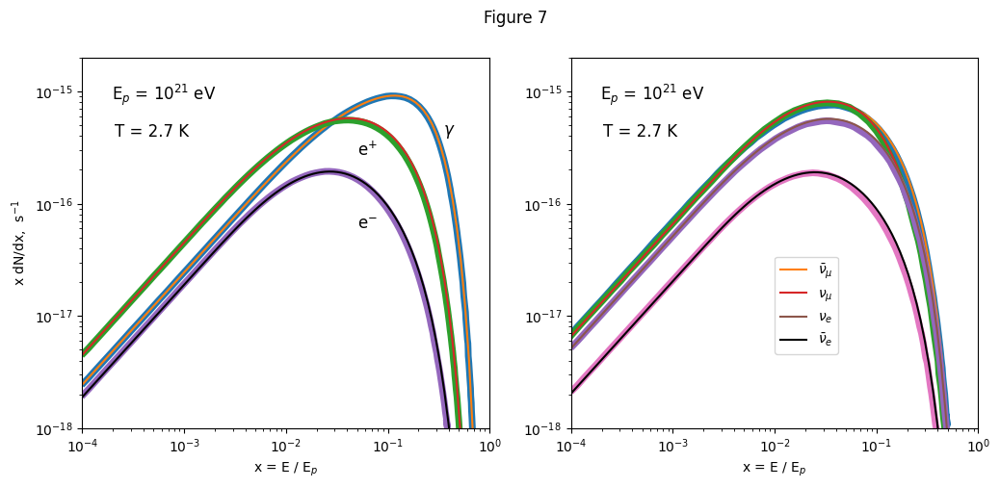

In [12]:
"""""
[KelnerAharonian2008] figure 7
"""

fig, ax = plt.subplots(1,2,figsize = (12, 5))

fig.suptitle("Figure 7")

Ep = (1e21 * u.Unit("eV")).to("erg")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig7_values/gamma.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"gamma"))

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig7_values/positron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"positron"))

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig7_values/electron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(x_val,xdNdx_val(x_val,Ep,"electron"),color="black")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig7_values/muon_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"muon_antineutrino"),label=r"$\bar{\nu}_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig7_values/muon_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"muon_neutrino"),label=r"$\nu_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig7_values/electron_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"electron_neutrino"),label=r"$\nu_{e}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig7_values/electron_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(x_val,xdNdx_val(x_val,Ep,"electron_antineutrino"),label=r"$\bar{\nu}_{e}$",color="black")

ax[0].set_xlim(1e-4,1e0)
ax[1].set_xlim(1e-4,1e0)

ax[0].set_ylim(1e-18,2e-15)
ax[1].set_ylim(1e-18,2e-15)

ax[0].set_xlabel(r"x = E / E$_{p}$")
ax[1].set_xlabel(r"x = E / E$_{p}$")

ax[0].set_ylabel(r"x dN/dx,  s$^{-1}$")

ax[0].text(0.20, 0.9, r"E$_{p}$ = 10$^{21}$ eV", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.17, 0.8, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.90, 0.8, r"$\gamma$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.70, 0.75, r"e$^{+}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.70, 0.55, r"e$^{-}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)

ax[1].text(0.2, 0.9, r"E$_{p}$ = 10$^{21}$ eV", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)
ax[1].text(0.17, 0.8, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

ax[1].legend(loc=(0.5,0.2))

In [13]:
def fp_pw(A,Ep,alfa):
    return (A.to_value("erg"))/((Ep.to_value("erg"))**alfa)*u.Unit("1 / (erg cm3)")

In [14]:
def H(eta, E, particle_type, A, alfa):
    # integral over Ep
    # Ep = (1e20 * u.Unit("eV")).to("erg")
    # E_star = (3.0e20 * u.Unit("eV")).to("erg")
    # print(E_star)

    Ep0 = E.to_value("erg")
    # eta_0 = 0.313
    # print(Ep0)
    # print(mpc2**2/4)
    

    # # # print(epsilon0)
    # # # print(np.log10(epsilon0))
    # # # print(np.logspace(np.log10(epsilon0),np.log10(epsilon0)+8,100))
    Ep_val = np.logspace(np.log10(Ep0),np.log10(Ep0)+8,100)*u.Unit("erg")
    # print(Ep_val)

    fp = fp_pw(A,Ep_val,alfa)
    # print(fp)

    # # # print(eps_val)
    # # # print(cmb_target((eps_val/h).to("Hz")))
    EE = eta * mpc2**2 / (4 * Ep_val)
    # print(EE)
    fph = cmb_target((EE/h).to("Hz"))
    # print(fph)
    # eta = 4.0 * E * Ep_val / (mpc2**2)
    # print(eta)

    phi_kernel = PhiKernel(particle_type)
    
    phi = phi_kernel(eta,E/Ep_val)
    # print(phi)
    # # # print(fph*phi)
    Y = ((mpc2**2)/4.0*(fp*fph*phi)/Ep_val**2).to_value("1 / (erg2 cm3 s)")
    # print(Y)
    X = Ep_val.to_value("erg")
    int_res = np.trapezoid(Y, x=X)*u.Unit("1 / (erg cm3 s)")
    # # # print(int_res)
    return int_res
    # return 0.0
    
# print(H(1.0,1.0e20*u.Unit("eV"),"gamma",2.0))

def H_val(eta_val, E, particle_type, A, alfa):
    _val = []

    for i in eta_val:
        # print(i*dNdx(i,Ep,"gamma"))
        _val.append(H(i,E,particle_type,A,alfa).to_value("1 / (erg cm3 s)"))
    
    return _val


eta_val = np.logspace(-1, 2, 100)
E_star = (3.0e20 * u.Unit("eV")).to("erg")
Eg = 0.5*E_star

Tab = H_val(eta_val*eta_0,Eg,"gamma",6.0e32*u.Unit("erg"), 2.0)

# H_val(eta_val*eta_0,Eg,"gamma",6.0e32*u.Unit("erg"), 2.0)

# x_val = np.logspace(1, 2, 100)

# def H(eta_val, E_, particle_type, A, alfa):

#     dNdx_vals = np.vectorize(lambda x: H_i(x, E_, particle_type, A, alfa).to_value("1 / (erg cm3 s)"))(eta_val)

#     return dNdx_vals

/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:86: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:86: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.

In [15]:
# print(Tab)

/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:86: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:86: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.

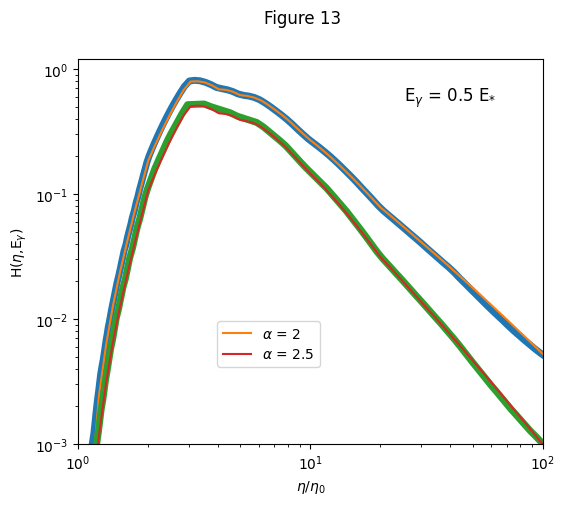

In [16]:
"""
[KelnerAharonian2008] figure 13
"""

fig, ax = plt.subplots(figsize = (6, 5))

fig.suptitle("Figure 13")

eta_val = np.logspace(-1, 2, 100)
E_star = (3.0e20 * u.Unit("eV")).to("erg")
Eg = 0.5*E_star

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig13_values/alfa_2.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax.loglog(x_i,spectrum,lw=5)

ax.loglog(eta_val,H_val(eta_val*eta_0,Eg,"gamma",5.2e32*u.Unit("erg"), 2.0),label=r"$\alpha$ = 2")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig13_values/alfa_2.5.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax.loglog(x_i,spectrum,lw=5)

ax.loglog(eta_val,H_val(eta_val*eta_0,Eg,"gamma", 1.1e37*u.Unit("erg"), 2.5),label=r"$\alpha$ = 2.5")

ax.set_xlim(1,1e2)
ax.set_ylim(1e-3,1.2)

ax.set_xlabel(r"$\eta$/$\eta_{0}$")
ax.set_ylabel(r"H($\eta$,E$_{\gamma}$)")

ax.text(0.80, 0.9, r"E$_{\gamma}$ = 0.5 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)

ax.legend(loc=(0.3,0.2))

In [17]:
def fp_ExpCutoff(A, Ep, Ecut):
    # return (A.to_value("erg"))/((Ep.to_value("erg"))**alfa)*u.Unit("1 / (erg cm3)")
    return A.to_value("erg / cm3") / (Ep.to_value("erg"))**2 * np.exp(-Ep.to_value("erg")/Ecut.to_value("erg"))*u.Unit("1 / (erg cm3)")

# print(fp_ExpCutoff(1.0*u.Unit("erg/cm3"),1.0*u.Unit("erg"),1.0*u.Unit("erg")))

In [18]:
def H(eta, E, particle_type, A, Ecut):
    # integral over Ep
    # Ep = (1e20 * u.Unit("eV")).to("erg")
    # E_star = (3.0e20 * u.Unit("eV")).to("erg")
    # print(E_star)

    Ep0 = E.to_value("erg")
    # eta_0 = 0.313
    # print(Ep0)
    # print(mpc2**2/4)
    

    # # # print(epsilon0)
    # # # print(np.log10(epsilon0))
    # # # print(np.logspace(np.log10(epsilon0),np.log10(epsilon0)+8,100))
    Ep_val = np.logspace(np.log10(Ep0),np.log10(Ep0)+8,100)*u.Unit("erg")
    # print(Ep_val)

    fp = fp_ExpCutoff(A, Ep_val, Ecut)
    # print(fp)

    # # # print(eps_val)
    # # # print(cmb_target((eps_val/h).to("Hz")))
    EE = eta * mpc2**2 / (4 * Ep_val)
    # print(EE)
    fph = cmb_target((EE/h).to("Hz"))
    # print(fph)
    # eta = 4.0 * E * Ep_val / (mpc2**2)
    # print(eta)

    phi_kernel = PhiKernel(particle_type)
    
    phi = phi_kernel(eta,E/Ep_val)
    # print(phi)
    # # # print(fph*phi)
    Y = ((mpc2**2)/4.0*(fp*fph*phi)/Ep_val**2).to_value("1 / (erg2 cm3 s)")
    # print(Y)
    X = Ep_val.to_value("erg")
    int_res = np.trapezoid(Y, x=X)*u.Unit("1 / (erg cm3 s)")
    # # # print(int_res)
    return int_res
    # return 0.0
    
# print(H(1.0,1.0e20*u.Unit("eV"),"gamma",2.0))

def H_val(eta_val, E, particle_type, A, alfa):
    _val = []

    for i in eta_val:
        # print(i*dNdx(i,Ep,"gamma"))
        _val.append(H(i,E,particle_type,A,alfa).to_value("1 / (erg cm3 s)"))
    
    return _val


eta_val = np.logspace(-1, 2, 100)
E_star = (3.0e20 * u.Unit("eV")).to("erg")
Eg = 0.5*E_star

Tab = H_val(eta_val*eta_0,Eg,"gamma",6.0e32*u.Unit("erg/cm3"), 6.0e32*u.Unit("erg"))

# H_val(eta_val*eta_0,Eg,"gamma",6.0e32*u.Unit("erg"), 2.0)

# x_val = np.logspace(1, 2, 100)

# def H(eta_val, E_, particle_type, A, alfa):

#     dNdx_vals = np.vectorize(lambda x: H_i(x, E_, particle_type, A, alfa).to_value("1 / (erg cm3 s)"))(eta_val)

#     return dNdx_vals

/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:86: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:86: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.

In [19]:
# print(Tab)


In [20]:
# """
# [KelnerAharonian2008] figure 13
# """

# fig, ax = plt.subplots(figsize = (6, 5))

# fig.suptitle("Figure 13")

# eta_val = np.logspace(-1, 6, 100)
# E_star = (3.0e20 * u.Unit("eV")).to("erg")
# Eg = 0.5*E_star

# ax.loglog(eta_val,H_val(eta_val*eta_0,Eg,"gamma",6.0e32*u.Unit("erg/cm3"), 6.0e19*u.Unit("eV")),label=r"$\alpha$ = 2")
# # ax.loglog(eta_val,H_val(eta_val*eta_0,Eg,"gamma", 1.0e37*u.Unit("erg"), 2.5),label=r"$\alpha$ = 2.5")

# # ax.set_xlim(1,1e2)
# # ax.set_ylim(1e-3,1.2)

# ax.set_xlabel(r"$\eta$/$\eta_{0}$")
# ax.set_ylabel(r"H($\eta$,E$_{\gamma}$)")

# ax.text(0.80, 0.9, r"E$_{\gamma}$ = 0.5 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)

# ax.legend(loc=(0.3,0.2))

In [21]:
def dNdE(E,particle_type,A,Ecut):
    eta_val = np.logspace(np.log10(eta_0),np.log10(eta_0)+8,100)
    # print(eta_val)

    Y = H_val(eta_val,E, particle_type, A, Ecut)
    X = eta_val
    
    return np.trapezoid(Y, x=X)

# print(Eg*dNdE(Eg,"gamma",6.0e1*u.Unit("erg/cm3"),6.0e19*u.Unit("eV")))

In [22]:
def dNdE_val(E_val, particle_type, A, Ecut):
    _val = []

    for i in E_val:
        # print(i*dNdx(i,Ep,"gamma"))
        _val.append((i*dNdE(i,particle_type,A,Ecut)).to_value("erg"))
    
    return _val

# E_val =  (np.logspace(17,21,10)*u.Unit("eV"))
# print(E_val)
# Tab = dNdE_val(E_val,"gamma",4.0e-2*u.Unit("erg/cm3"),10*E_star)

In [23]:
# print(Tab)

In [24]:
def normalization(A,Ecut):
    oneGeV = (1.0 * u.Unit("GeV")).to_value("erg")
    Ep_val = np.logspace(np.log10(oneGeV),np.log10(oneGeV)+10,1000)*u.Unit("erg")

    Y = []
    for i in Ep_val:
        Y.append((i*fp_ExpCutoff(A,i,Ecut)).to_value("1/cm3"))

    X = Ep_val.to_value("erg")

    return np.trapezoid(Y,x=X)*u.Unit("erg/cm3")

In [25]:
A = 4.0e-2*u.Unit("erg/cm3")
E_cut = 1e-1*E_star
print(normalization(A,E_cut))

0.9088159386088839 erg / cm3


In [26]:
E_star = (3.0e20 * u.Unit("eV")).to("erg")
E_cut = 1e-1*E_star
A = 4.0e-2*u.Unit("erg/cm3")

E_val =  (np.logspace(17,21,20)*u.Unit("eV"))

dNdE_gamma = dNdE_val(E_val,"gamma",A,E_cut)
dNdE_positron = dNdE_val(E_val,"positron",A,E_cut)
dNdE_electron = dNdE_val(E_val,"electron",A,E_cut)

dNdE_muon_antineutrino = dNdE_val(E_val,"muon_antineutrino",A,E_cut)
dNdE_muon_neutrino = dNdE_val(E_val,"muon_neutrino",A,E_cut)
dNdE_electron_neutrino = dNdE_val(E_val,"electron_neutrino",A,E_cut)
dNdE_electron_antineutrino = dNdE_val(E_val,"electron_antineutrino",A,E_cut)

/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:86: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid value encountered in po

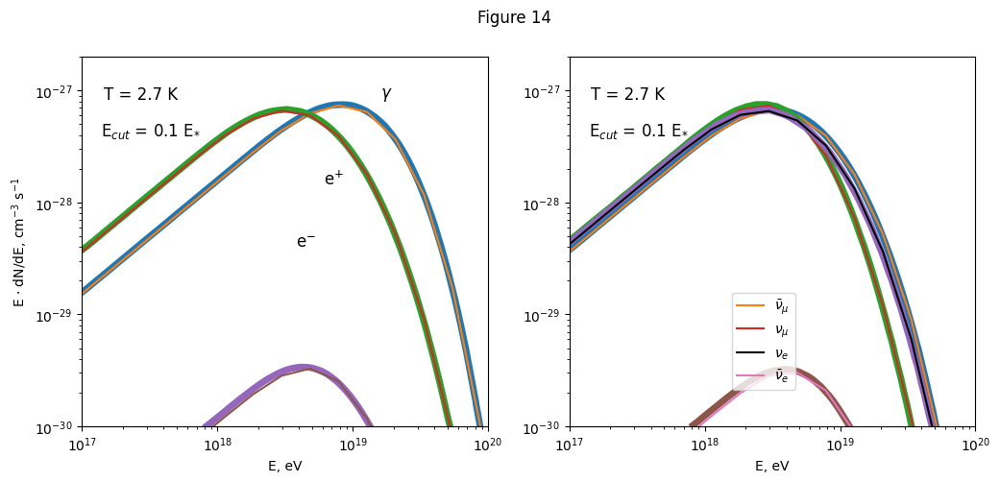

In [27]:
"""
[KelnerAharonian2008] figure 14
"""

fig, ax = plt.subplots(1,2,figsize = (12, 5))

fig.suptitle("Figure 14")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig14_values/gamma.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_gamma)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig14_values/positron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_positron)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig14_values/electron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_electron)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig14_values/muon_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_muon_antineutrino,label=r"$\bar{\nu}_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig14_values/muon_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_muon_neutrino,label=r"$\nu_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig14_values/electron_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_electron_neutrino,label=r"$\nu_{e}$",color="black")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig14_values/electron_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_electron_antineutrino,label=r"$\bar{\nu}_{e}$")

# ax.loglog(eta_val,H_val(eta_val*eta_0,Eg,"gamma", 1.0e37*u.Unit("erg"), 2.5),label=r"$\alpha$ = 2.5")

ax[0].set_xlim(1e17,1e20)
ax[0].set_ylim(1e-30,2e-27)

ax[1].set_xlim(1e17,1e20)
ax[1].set_ylim(1e-30,2e-27)

ax[0].set_xlabel(r"E, eV")
ax[0].set_ylabel(r"E $\cdot$ dN/dE, cm$^{-3}$ s$^{-1}$")

ax[1].set_xlabel(r"E, eV")
# ax[1].set_ylabel(r"E $\cdot$ dN/dE, cm$^{-3}$ s$^{-1}$")

ax[0].text(0.145, 0.9, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.17, 0.8, r"E$_{cut}$ = 0.1 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.75, 0.9, r"$\gamma$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.62, 0.67, r"e$^{+}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.55, 0.5, r"e$^{-}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)

ax[1].text(0.145, 0.9, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)
ax[1].text(0.17, 0.8, r"E$_{cut}$ = 0.1 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

# ax.text(0.80, 0.9, r"E$_{\gamma}$ = 0.5 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)

ax[1].legend(loc=(0.4,0.1))

In [28]:
A = 4.0e-2*u.Unit("erg/cm3")
E_cut = 1e0*E_star
print(normalization(A,E_cut))

0.9197932855042013 erg / cm3


In [29]:
E_star = (3.0e20 * u.Unit("eV")).to("erg")
E_cut = 1e0*E_star
A = 4.0e-2*u.Unit("erg/cm3")

E_val =  (np.logspace(17,21,20)*u.Unit("eV"))

dNdE_gamma = dNdE_val(E_val,"gamma",A,E_cut)
dNdE_positron = dNdE_val(E_val,"positron",A,E_cut)
dNdE_electron = dNdE_val(E_val,"electron",A,E_cut)

dNdE_muon_antineutrino = dNdE_val(E_val,"muon_antineutrino",A,E_cut)
dNdE_muon_neutrino = dNdE_val(E_val,"muon_neutrino",A,E_cut)
dNdE_electron_neutrino = dNdE_val(E_val,"electron_neutrino",A,E_cut)
dNdE_electron_antineutrino = dNdE_val(E_val,"electron_antineutrino",A,E_cut)

/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:86: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid value encountered in po

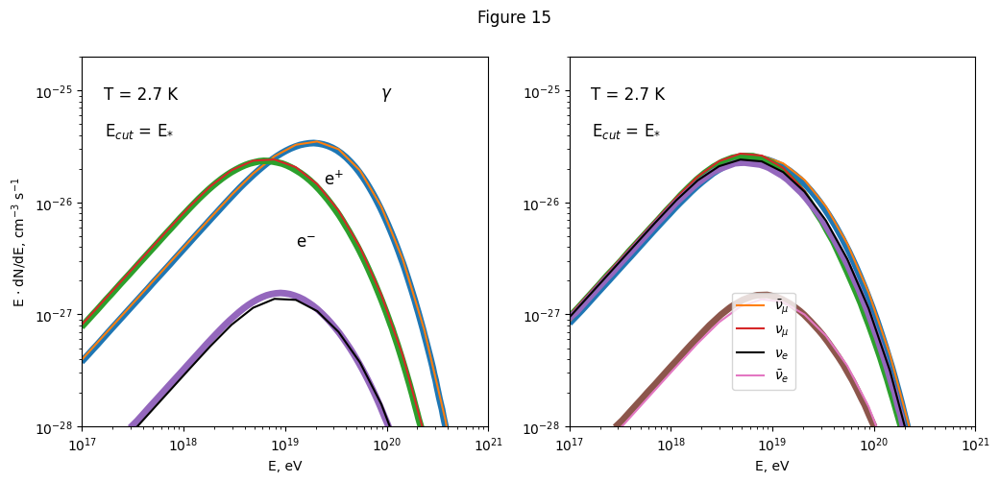

In [30]:
"""
[KelnerAharonian2008] figure 15
"""

fig, ax = plt.subplots(1,2,figsize = (12, 5))

fig.suptitle("Figure 15")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig15_values/gamma.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_gamma)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig15_values/positron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_positron)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig15_values/electron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_electron,color="black")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig15_values/muon_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_muon_antineutrino,label=r"$\bar{\nu}_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig15_values/muon_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_muon_neutrino,label=r"$\nu_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig15_values/electron_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_electron_neutrino,label=r"$\nu_{e}$",color="black")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig15_values/electron_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_electron_antineutrino,label=r"$\bar{\nu}_{e}$")

# ax.loglog(eta_val,H_val(eta_val*eta_0,Eg,"gamma", 1.0e37*u.Unit("erg"), 2.5),label=r"$\alpha$ = 2.5")

ax[0].set_xlim(1e17,1e21)
ax[0].set_ylim(1e-28,2e-25)

ax[1].set_xlim(1e17,1e21)
ax[1].set_ylim(1e-28,2e-25)

ax[0].set_xlabel(r"E, eV")
ax[0].set_ylabel(r"E $\cdot$ dN/dE, cm$^{-3}$ s$^{-1}$")

ax[1].set_xlabel(r"E, eV")
# ax[1].set_ylabel(r"E $\cdot$ dN/dE, cm$^{-3}$ s$^{-1}$")

ax[0].text(0.145, 0.9, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.14, 0.8, r"E$_{cut}$ = E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.75, 0.9, r"$\gamma$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.62, 0.67, r"e$^{+}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.55, 0.5, r"e$^{-}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)

ax[1].text(0.145, 0.9, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)
ax[1].text(0.14, 0.8, r"E$_{cut}$ = E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

# ax.text(0.80, 0.9, r"E$_{\gamma}$ = 0.5 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)

ax[1].legend(loc=(0.4,0.1))

In [31]:
A = 4.0e-2*u.Unit("erg/cm3")
E_cut = 1e1*E_star
print(normalization(A,E_cut))

0.9209823672218265 erg / cm3


In [32]:
E_star = (3.0e20 * u.Unit("eV")).to("erg")
E_cut = 1e1*E_star
A = 4.0e-2*u.Unit("erg/cm3")

E_val =  (np.logspace(17,21,20)*u.Unit("eV"))

dNdE_gamma = dNdE_val(E_val,"gamma",A,E_cut)
dNdE_positron = dNdE_val(E_val,"positron",A,E_cut)
dNdE_electron = dNdE_val(E_val,"electron",A,E_cut)

dNdE_muon_antineutrino = dNdE_val(E_val,"muon_antineutrino",A,E_cut)
dNdE_muon_neutrino = dNdE_val(E_val,"muon_neutrino",A,E_cut)
dNdE_electron_neutrino = dNdE_val(E_val,"electron_neutrino",A,E_cut)
dNdE_electron_antineutrino = dNdE_val(E_val,"electron_antineutrino",A,E_cut)

/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:86: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid value encountered in po

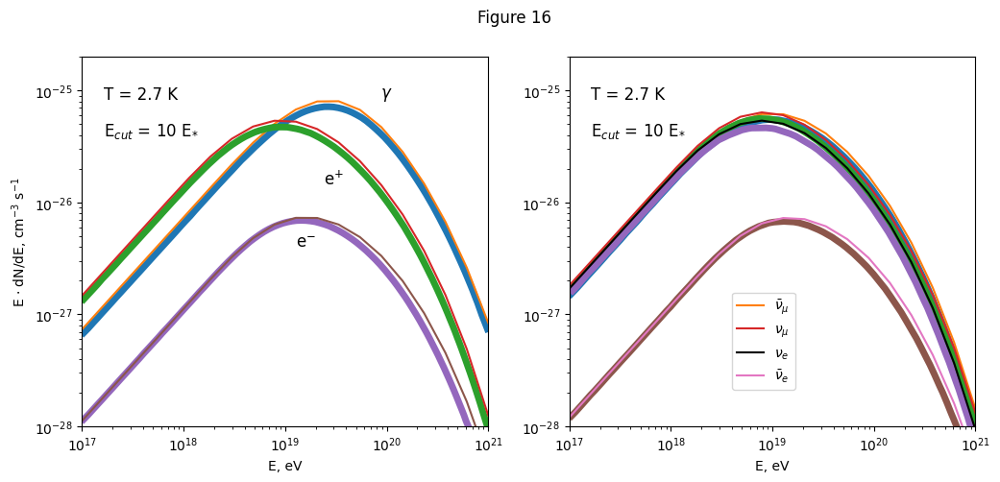

In [33]:
"""
[KelnerAharonian2008] figure 16
"""

fig, ax = plt.subplots(1,2,figsize = (12, 5))

fig.suptitle("Figure 16")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig16_values/gamma.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_gamma)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig16_values/positron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_positron)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig16_values/electron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_electron)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig16_values/muon_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_muon_antineutrino,label=r"$\bar{\nu}_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig16_values/muon_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_muon_neutrino,label=r"$\nu_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig16_values/electron_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_electron_neutrino,label=r"$\nu_{e}$",color="black")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig16_values/electron_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_electron_antineutrino,label=r"$\bar{\nu}_{e}$")

# ax.loglog(eta_val,H_val(eta_val*eta_0,Eg,"gamma", 1.0e37*u.Unit("erg"), 2.5),label=r"$\alpha$ = 2.5")

ax[0].set_xlim(1e17,1e21)
ax[0].set_ylim(1e-28,2e-25)

ax[1].set_xlim(1e17,1e21)
ax[1].set_ylim(1e-28,2e-25)

ax[0].set_xlabel(r"E, eV")
ax[0].set_ylabel(r"E $\cdot$ dN/dE, cm$^{-3}$ s$^{-1}$")

ax[1].set_xlabel(r"E, eV")
# ax[1].set_ylabel(r"E $\cdot$ dN/dE, cm$^{-3}$ s$^{-1}$")

ax[0].text(0.145, 0.9, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.17, 0.8, r"E$_{cut}$ = 10 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.75, 0.9, r"$\gamma$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.62, 0.67, r"e$^{+}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.55, 0.5, r"e$^{-}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)

ax[1].text(0.145, 0.9, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)
ax[1].text(0.17, 0.8, r"E$_{cut}$ = 10 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

# ax.text(0.80, 0.9, r"E$_{\gamma}$ = 0.5 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)

ax[1].legend(loc=(0.4,0.1))

In [34]:
A = 4.0e-2*u.Unit("erg/cm3")
E_cut = 1e3*E_star
print(normalization(A,E_cut))

0.9211142562040735 erg / cm3


In [35]:
E_star = (3.0e20 * u.Unit("eV")).to("erg")
E_cut = 1e3*E_star
A = 3.7e-2*u.Unit("erg/cm3")

E_val =  (np.logspace(17,21,20)*u.Unit("eV"))

dNdE_gamma = dNdE_val(E_val,"gamma",A,E_cut)
dNdE_positron = dNdE_val(E_val,"positron",A,E_cut)
dNdE_electron = dNdE_val(E_val,"electron",A,E_cut)

dNdE_muon_antineutrino = dNdE_val(E_val,"muon_antineutrino",A,E_cut)
dNdE_muon_neutrino = dNdE_val(E_val,"muon_neutrino",A,E_cut)
dNdE_electron_neutrino = dNdE_val(E_val,"electron_neutrino",A,E_cut)
dNdE_electron_antineutrino = dNdE_val(E_val,"electron_antineutrino",A,E_cut)

/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:74: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/agnpy/photo_meson/tests/../../../agnpy/photo_meson/kernels.py:86: RuntimeWarning: invalid value encountered in sqrt
  x_2 = np.sqrt((eta - r**2 - 2 * r) * (eta - r**2 + 2 * r))
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: overflow encountered in expm1
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/piotr/Dokumenty/CODE/agnpy/.venv/lib/python3.12/site-packages/astropy/units/quantity.py:648: RuntimeWarning: invalid value encountered in po

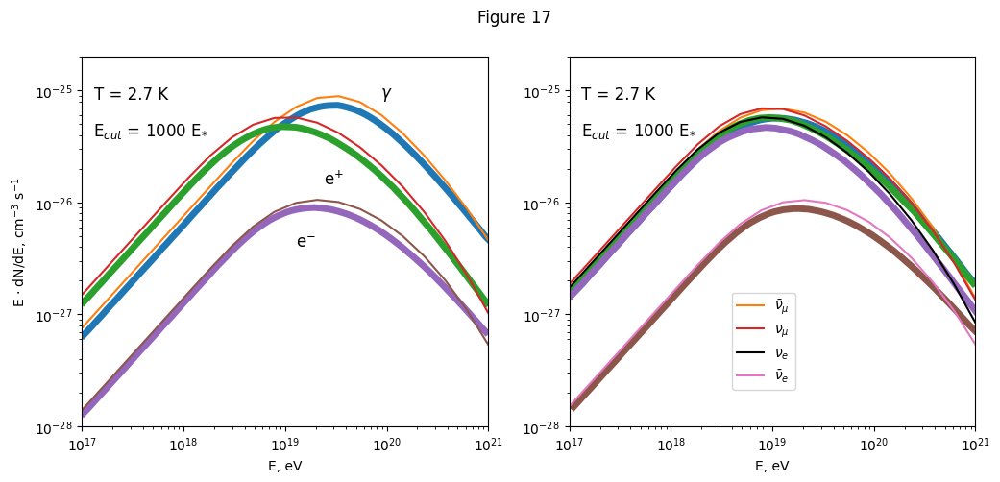

In [36]:
"""
[KelnerAharonian2008] figure 17
"""

fig, ax = plt.subplots(1,2,figsize = (12, 5))

fig.suptitle("Figure 17")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig17_values/gamma.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_gamma)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig17_values/positron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_positron)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig17_values/electron.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[0].loglog(x_i,spectrum,lw=5)

ax[0].loglog(E_val.to_value("eV"),dNdE_electron)

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig17_values/muon_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_muon_antineutrino,label=r"$\bar{\nu}_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig17_values/muon_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_muon_neutrino,label=r"$\nu_{\mu}$")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig17_values/electron_neutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_electron_neutrino,label=r"$\nu_{e}$",color="black")

x_i, spectrum= np.genfromtxt("../../data/photo_meson/kelner_aharonian_2008/fig17_values/electron_antineutrino.txt", 
                          dtype="float", 
                          delimiter=";",
                          comments="#", 
                          usecols=(0, 1), 
                          unpack="True",
                          converters={0: lambda x: float(x.replace(',', '.')),
                                      1: lambda x: float(x.replace(',', '.'))})

x_i = np.power(10,x_i)
spectrum = np.power(10,spectrum)

ax[1].loglog(x_i,spectrum,lw=5)

ax[1].loglog(E_val.to_value("eV"),dNdE_electron_antineutrino,label=r"$\bar{\nu}_{e}$")

# ax.loglog(eta_val,H_val(eta_val*eta_0,Eg,"gamma", 1.0e37*u.Unit("erg"), 2.5),label=r"$\alpha$ = 2.5")

ax[0].set_xlim(1e17,1e21)
ax[0].set_ylim(1e-28,2e-25)

ax[1].set_xlim(1e17,1e21)
ax[1].set_ylim(1e-28,2e-25)

ax[0].set_xlabel(r"E, eV")
ax[0].set_ylabel(r"E $\cdot$ dN/dE, cm$^{-3}$ s$^{-1}$")

ax[1].set_xlabel(r"E, eV")
# ax[1].set_ylabel(r"E $\cdot$ dN/dE, cm$^{-3}$ s$^{-1}$")

ax[0].text(0.12, 0.9, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.17, 0.8, r"E$_{cut}$ = 1000 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.75, 0.9, r"$\gamma$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.62, 0.67, r"e$^{+}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)
ax[0].text(0.55, 0.5, r"e$^{-}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[0].transAxes)

ax[1].text(0.12, 0.9, r"T = 2.7 K", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)
ax[1].text(0.17, 0.8, r"E$_{cut}$ = 1000 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax[1].transAxes)

# ax.text(0.80, 0.9, r"E$_{\gamma}$ = 0.5 E$_{*}$", fontsize=12, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes)

ax[1].legend(loc=(0.4,0.1))